# Introduction to Machine Learning Prediction: 
# An Example Using House Prediction Dataset¶

## Goal

This notebook is designed to develop a model that helps *Real Estate Sales Agents* accurately predict house prices (i.e., SalePrice). The objectives are:

1. To enable agents to better assess the value of a house when owners are looking to sell.
2. To help agents understand the budget of buyers based on their descriptions of an ideal house.

In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

In [2]:
# code for getting the datasets on your local PC
# !pip install opendatasets
import opendatasets as od

In [3]:
od.download("https://www.kaggle.com/competitions/house-prices-advanced-regression-techniques/data")

Skipping, found downloaded files in ".\house-prices-advanced-regression-techniques" (use force=True to force download)


In [4]:
train = pd.read_csv('../Kaggle/house-prices-advanced-regression-techniques/train.csv')
test = pd.read_csv('../Kaggle/house-prices-advanced-regression-techniques/test.csv')

In [5]:
# code if you are running it on Kaggle
# import numpy as np # linear algebra
# import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
#         print(os.path.join(dirname, filename))

In [6]:
# train = pd.read_csv('../input/house-prices-advanced-regression-techniques/train.csv')
# test = pd.read_csv('../input/house-prices-advanced-regression-techniques/test.csv')

In [7]:
pd.set_option('display.max_columns', 500)

train.head(1)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,NaN,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,BrkFace,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,NaN,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,NaN,NaN,NaN,0,2,2008,WD,Normal,208500


## 1. Data PreProcessing

Before analyzing data, it is necessary to preprocess:

1. Fill in or drop missing values.
2. Standardize numerical data.
3. Transform categorical data.

### 1.1 Fill/Drop Missing Value

First, assess the extent of missing values in each column:

1. Columns with a significant amount of missing data (typically over half) should be considered for removal, as filling such gaps might not representatively reflect the population.
2. For numerical columns, fill missing values with the median if the data distribution is skewed, or with the mean if it is normal.
3. For categorical columns, use the mode to fill missing values.

In [8]:
# Description for all columns
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1460 entries, 0 to 1459
Data columns (total 81 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1460 non-null   int64  
 1   MSSubClass     1460 non-null   int64  
 2   MSZoning       1460 non-null   object 
 3   LotFrontage    1201 non-null   float64
 4   LotArea        1460 non-null   int64  
 5   Street         1460 non-null   object 
 6   Alley          91 non-null     object 
 7   LotShape       1460 non-null   object 
 8   LandContour    1460 non-null   object 
 9   Utilities      1460 non-null   object 
 10  LotConfig      1460 non-null   object 
 11  LandSlope      1460 non-null   object 
 12  Neighborhood   1460 non-null   object 
 13  Condition1     1460 non-null   object 
 14  Condition2     1460 non-null   object 
 15  BldgType       1460 non-null   object 
 16  HouseStyle     1460 non-null   object 
 17  OverallQual    1460 non-null   int64  
 18  OverallC

In [10]:
# count number of missing values in columns
check = train.isnull().sum() 
check[check>0]

LotFrontage      259
Alley           1369
MasVnrType         8
MasVnrArea         8
BsmtQual          37
BsmtCond          37
BsmtExposure      38
BsmtFinType1      37
BsmtFinType2      38
Electrical         1
FireplaceQu      690
GarageType        81
GarageYrBlt       81
GarageFinish      81
GarageQual        81
GarageCond        81
PoolQC          1453
Fence           1179
MiscFeature     1406
dtype: int64

**Drop the columns with a lot of missing value**

In [11]:
train.drop(['Alley','MasVnrType','FireplaceQu','PoolQC','Fence','MiscFeature'], axis=1, inplace = True)

In [12]:
train.head(1)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SaleType,SaleCondition,SalePrice
0,1,60,RL,65.0,8450,Pave,Reg,Lvl,AllPub,Inside,Gtl,CollgCr,Norm,Norm,1Fam,2Story,7,5,2003,2003,Gable,CompShg,VinylSd,VinylSd,196.0,Gd,TA,PConc,Gd,TA,No,GLQ,706,Unf,0,150,856,GasA,Ex,Y,SBrkr,856,854,0,1710,1,0,2,1,3,1,Gd,8,Typ,0,Attchd,2003.0,RFn,2,548,TA,TA,Y,0,61,0,0,0,0,0,2,2008,WD,Normal,208500


**Fill the numeric columns with median, and categorical columns with mode**

In [13]:
train = train.apply(lambda col: col.fillna(col.median()) if col.dtype != 'object' else col.fillna(col.mode().iloc[0]))

In [14]:
train.isnull().any().sum()

0

### 1.2 Standardize numeric data

Standardizing numerical data is crucial for several reasons:

1. It enhances model performance, particularly for distance-based models (e.g., K-nearest neighbors, linear regression). For instance, if model inputs include both living area (in square feet) and number of bedrooms, the larger range of living area values could disproportionately influence the model. Standardizing these features ensures they contribute equally to the result.
2. It aids in the interpretation and comparison of different features' impacts on the predicted house price, especially useful in econometric models.

Standardization adjusts each feature to have a mean close to 0 and a standard deviation around 1. 

In [15]:
# split the data into numeric and category
    # leveraging pandas.DataFrame.select_dtypes
num= train.select_dtypes(include=np.number)
cat= train.select_dtypes(include="object") 

In [16]:
num.head()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal,MoSold,YrSold,SalePrice
0,1,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0,2,2008,208500
1,2,20,80.0,9600,6,8,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0,5,2007,181500
2,3,60,68.0,11250,7,5,2001,2002,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0,9,2008,223500
3,4,70,60.0,9550,7,5,1915,1970,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0,2,2006,140000
4,5,60,84.0,14260,8,5,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0,12,2008,250000


In [17]:
# separate target, year_month from numeric features
y_train = num['SalePrice']
year_month = num[['MoSold','YrSold']]

num.drop(['MoSold','YrSold','SalePrice'], axis=1, inplace = True)

In [18]:
num.head(1)

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal
0,1,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0


In [19]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
num_transformed = pd.DataFrame(scaler.fit_transform(num), columns=num.columns)

In [20]:
num_transformed.describe()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal
count,1460.000000,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03,1.460000e+03
mean,0.000000,-8.455945e-17,2.798370e-16,-5.840077e-17,1.387018e-16,3.540547e-16,1.046347e-15,4.496860e-15,-3.893385e-17,-2.433366e-17,-3.406712e-17,-6.600504e-17,2.457699e-16,6.509253e-17,-1.825024e-17,1.216683e-17,-1.277517e-16,2.311697e-17,2.433366e-17,1.180182e-16,2.083569e-17,2.141362e-16,4.501726e-16,-1.022014e-16,-4.866731e-18,-2.851296e-15,1.216683e-16,-1.216683e-17,5.596741e-17,3.041707e-17,-2.311697e-17,4.866731e-18,5.475072e-17,1.946692e-17,-2.676702e-17
std,1.000343,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00,1.000343e+00
min,-1.730865,-8.725628e-01,-2.219047e+00,-9.237292e-01,-3.688413e+00,-4.112970e+00,-3.287824e+00,-1.689368e+00,-5.707501e-01,-9.730182e-01,-2.886528e-01,-1.284176e+00,-2.411167e+00,-2.144172e+00,-7.951632e-01,-1.202417e-01,-2.249120e+00,-8.199644e-01,-2.410610e-01,-2.841822e+00,-7.616207e-01,-3.514952e+00,-4.751486e+00,-2.780469e+00,-9.512265e-01,-3.276072e+00,-2.365440e+00,-2.212963e+00,-7.521758e-01,-7.044833e-01,-3.593249e-01,-1.163393e-01,-2.702084e-01,-6.869175e-02,-8.768781e-02
25%,-0.865432,-8.725628e-01,-4.479400e-01,-2.969908e-01,-7.951515e-01,-5.171998e-01,-5.719226e-01,-8.656586e-01,-5.707501e-01,-9.730182e-01,-2.886528e-01,-7.793259e-01,-5.966855e-01,-7.261556e-01,-7.951632e-01,-1.202417e-01,-7.347485e-01,-8.199644e-01,-2.410610e-01,-1.026041e+00,-7.616207e-01,-1.062465e+00,-2.114536e-01,-9.341298e-01,-9.512265e-01,-6.915327e-01,-1.026858e+00,-6.479160e-01,-7.521758e-01,-7.044833e-01,-3.593249e-01,-1.163393e-01,-2.702084e-01,-6.869175e-02,-8.768781e-02
50%,0.000000,-1.631095e-01,-3.922314e-02,-1.040633e-01,-7.183611e-02,-5.171998e-01,5.737148e-02,4.425864e-01,-5.707501e-01,-1.319022e-01,-2.886528e-01,-2.031633e-01,-1.503334e-01,-1.956933e-01,-7.951632e-01,-1.202417e-01,-9.797004e-02,-8.199644e-01,-2.410610e-01,7.897405e-01,-7.616207e-01,1.637791e-01,-2.114536e-01,-3.186833e-01,6.004949e-01,5.881740e-02,3.117246e-01,3.284429e-02,-7.521758e-01,-3.270298e-01,-3.593249e-01,-1.163393e-01,-2.702084e-01,-6.869175e-02,-8.768781e-02
75%,0.865432,3.098594e-01,4.149067e-01,1.087080e-01,6.514792e-01,3.817427e-01,9.516316e-01,9.271216e-01,3.383686e-01,5.891327e-01,-2.886528e-01,5.450557e-01,5.491227e-01,5.915905e-01,8.731117e-01,-1.202417e-01,4.974036e-01,1.107810e+00,-2.410610e-01,7.897405e-01,1.227585e+00,1.637791e-01,-2.114536e-01,2.967633e-01,6.004949e-01,9.342258e-01,3.117246e-01,4.820057e-01,5.886506e-01,3.221901e-01,-3.593249e-01,-1.163393e-01,-2.702084e-01,-6.869175e-02,-8.768781e-02
max,1.730865,3.147673e+00,1.104155e+01,2.051827e+01,2.821425e+00,3.078570e+00,1.282839e+00,1.217843e+00,8.285201e+00,1.140575e+01,8.851638e+00,4.004295e+00,1.152095e+01,9.132681e+00,3.936963e+00,1.164775e+01,7.855574e+00,4.963359e+00,8.138680e+00,2.605522e+00,3.216791e+00,6.294997e+00,8.868612e+00,4.604889e

### 1.3 Transform Categorical Data

I convert all categorical variables into dummy variables using 'one-hot encoding' techniques. In this process, each categorical column from the dataframe is expanded into several binary columns, corresponding to the unique values minus one, to prevent multicollinearity.

For instance, the 'Slope of property' category, which can be gentle, moderate, or severe, is encoded into two columns: one for gentle and another for moderate. A severe slope is implied if neither gentle nor moderate is indicated.

One-hot encoding, however, has limitations. It can greatly increase the dimensionality of the dataset when a category has numerous unique values, leading to sparse matrices and potential overfitting. In the feature selection phase, I aim to mitigate these issues.

In [21]:
# get unique value for each column

cat.apply(lambda col: col.unique())

MSZoning                                 [RL, RM, C (all), FV, RH]
Street                                                [Pave, Grvl]
LotShape                                      [Reg, IR1, IR2, IR3]
LandContour                                   [Lvl, Bnk, Low, HLS]
Utilities                                         [AllPub, NoSeWa]
LotConfig                      [Inside, FR2, Corner, CulDSac, FR3]
LandSlope                                          [Gtl, Mod, Sev]
Neighborhood     [CollgCr, Veenker, Crawfor, NoRidge, Mitchel, ...
Condition1       [Norm, Feedr, PosN, Artery, RRAe, RRNn, RRAn, ...
Condition2       [Norm, Artery, RRNn, Feedr, PosN, PosA, RRAn, ...
BldgType                     [1Fam, 2fmCon, Duplex, TwnhsE, Twnhs]
HouseStyle       [2Story, 1Story, 1.5Fin, 1.5Unf, SFoyer, SLvl,...
RoofStyle               [Gable, Hip, Gambrel, Mansard, Flat, Shed]
RoofMatl         [CompShg, WdShngl, Metal, WdShake, Membran, Ta...
Exterior1st      [VinylSd, MetalSd, Wd Sdng, HdBoard, BrkFace,

In [22]:
cat_transformed = pd.get_dummies(cat,drop_first=True)

In [23]:
cat_transformed=cat_transformed.astype(int)

In [24]:
cat_transformed.head(2)

,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtCond_Gd,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0
1,0,0,1,0,1,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,1,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0

## 2. Feature Engineering 


### 2.1 Time Features

Real estate activity exhibits notable seasonal variations. For instance, as noted by [Investopedia](https://www.investopedia.com/articles/investing/010717/seasons-impact-real-estate-more-you-think.asp), the holiday season and school calendar significantly influence housing prices. Additionally, certain years may see higher or lower prices due to macroeconomic factors.

Given this, both the year and seasonal patterns are crucial for accurate predictions.

I begin by examining scatter plots of housing data by year-month, color-coded by year, although initial patterns may appear unclear.

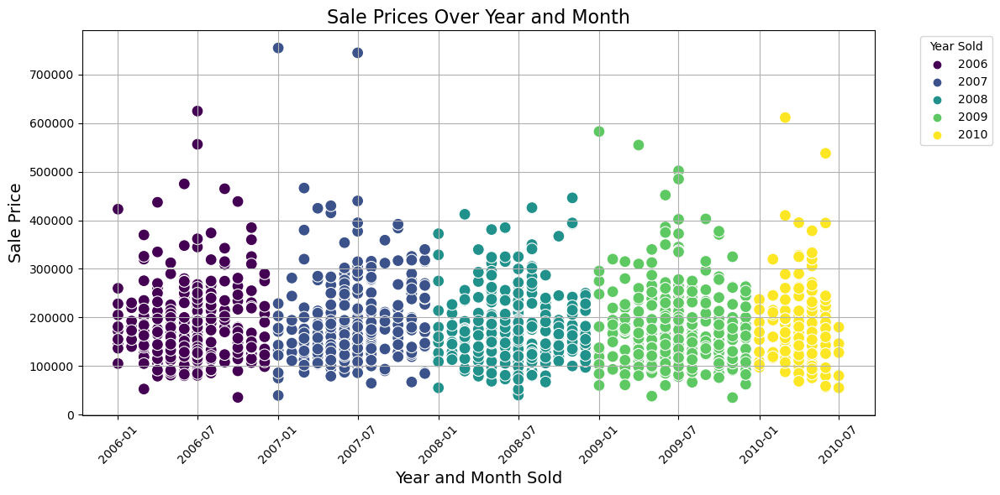

In [25]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Combine Year and Month into a Datetime column
train['YearMonthSold'] = pd.to_datetime(train['YrSold'].astype(str) + '-' + train['MoSold'].astype(str))

# Create a scatter plot
plt.figure(figsize=(12, 6))
sns.scatterplot(data=train, x='YearMonthSold', y='SalePrice', hue='YrSold', palette='viridis', s=100)

# Titles and Labels
plt.title('Sale Prices Over Year and Month', fontsize=16)
plt.xlabel('Year and Month Sold', fontsize=14)
plt.ylabel('Sale Price', fontsize=14)
plt.xticks(rotation=45)
plt.grid(True)
plt.legend(title='Year Sold', bbox_to_anchor=(1.05, 1), loc='upper left')

# Display the plot
plt.tight_layout()
plt.show()


I then plot the median house price for each year-month, revealing clearer seasonal trends:

1 There is a recurring annual cycle with prices dipping around April to June.
2. The housing market suffered significantly during the financial crisis, evident from a sharp decline in prices after January 2008, with no recovery in the subsequent two years.

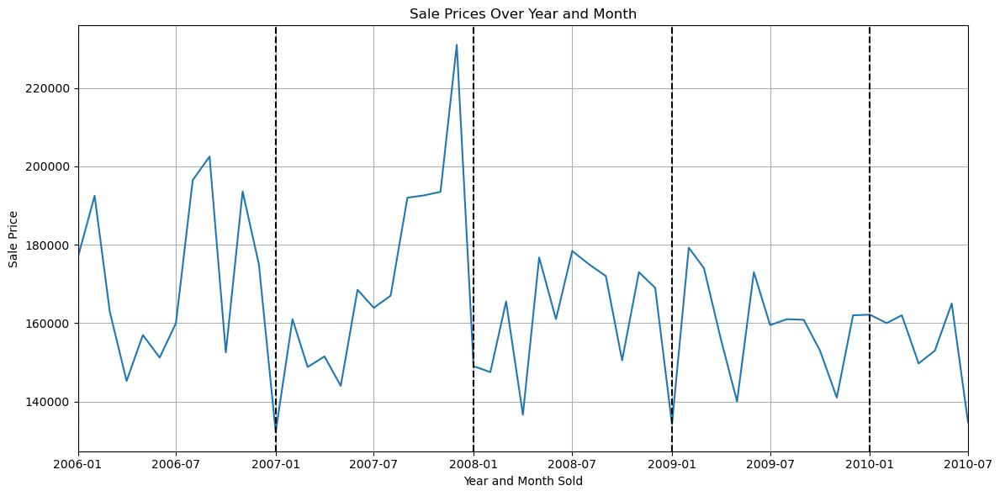

In [26]:
temp = train.groupby('YearMonthSold')['SalePrice'].median().reset_index()

import matplotlib.pyplot as plt

plt.figure(figsize=(12, 6))
plt.plot(temp['YearMonthSold'], temp['SalePrice'], linestyle='-') # marker='o',

xcoords = ['2006-01', '2007-01', '2008-01', '2009-01', '2010-01']
for xc in xcoords:
    plt.axvline(pd.to_datetime(xc), color='black', linestyle='--')

plt.xlim(pd.to_datetime('2006-01'), pd.to_datetime('2010-07'))
plt.title('Sale Prices Over Year and Month')
plt.xlabel('Year and Month Sold')
plt.ylabel('Sale Price')
plt.grid(True)

plt.tight_layout()
plt.show()

However, discerning seasonal patterns post-2008 is challenging, potentially due to confounding factors like trends and residuals. Using the **seasonal_decompose** function, I can dissect the time series into:

                    $$Y_t = Seasonal_t*Trend_t*Residuals_t$$
                    
1. Seasonality: Typically, prices are lower in winter and peak in late summer.
2. Trend: The trend is less distinct pre-2008 but shows a marked decline thereafter. Instead of using a continuous trend variable, I utilize a binary variable indicating the financial crisis for inclusion in the predictive model.

(array([13149., 13330., 13514., 13695., 13879., 14061., 14245., 14426.,
        14610., 14791.]),
 [Text(13149.0, 0, '2006-01'),
  Text(13330.0, 0, '2006-07'),
  Text(13514.0, 0, '2007-01'),
  Text(13695.0, 0, '2007-07'),
  Text(13879.0, 0, '2008-01'),
  Text(14061.0, 0, '2008-07'),
  Text(14245.0, 0, '2009-01'),
  Text(14426.0, 0, '2009-07'),
  Text(14610.0, 0, '2010-01'),
  Text(14791.0, 0, '2010-07')])

<Figure size 1500x500 with 0 Axes>

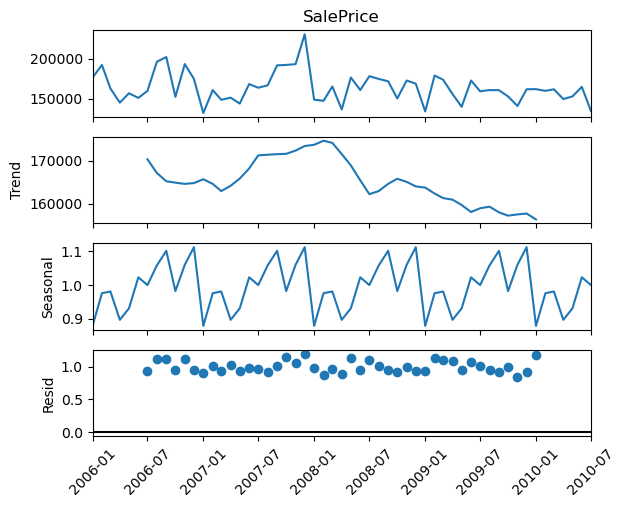

In [27]:
from statsmodels.tsa.seasonal import seasonal_decompose
temp.set_index('YearMonthSold', inplace=True)

# capture monthly seasonality
decompose = seasonal_decompose(temp['SalePrice'],model = 'multiplicative', period=12)
plt.figure(figsize = (15,5))
year_month_plot = decompose.plot()
plt.xticks(rotation=45)


In [28]:
# store the result in dataframe
temp['seasonal'] = decompose.seasonal
temp['trend'] = decompose.trend

In [29]:
# transform YearMonthSold back to column
temp.reset_index(inplace=True)

In [30]:
temp['YearMonthSold'] = temp['YearMonthSold'].dt.strftime('%Y-%m')

Create binary variable indicating finicial crisis

In [31]:
temp['is_crisis'] = 0
temp.loc[temp['YearMonthSold']>= '2008-01', 'is_crisis']=1

In [32]:
temp.head(1)

,YearMonthSold,SalePrice,seasonal,trend,is_crisis
0,2006-01,176700.0,0.878202,NaN,0


In [33]:
temp.shape

(55, 5)

In [34]:
year_month.shape

(1460, 2)

Adding the two variable back to year_month dataframe

In [35]:
# Ensure the YearMonthSold column is in the same format
year_month.loc[:,'YearMonthSold'] = pd.to_datetime(year_month['YrSold'].astype(str) + '-' + year_month['MoSold'].astype(str))


year_month['YearMonthSold'] = pd.to_datetime(year_month['YearMonthSold'], format='%Y-%m')
temp['YearMonthSold'] = pd.to_datetime(temp['YearMonthSold'], format='%Y-%m')

C:\Users\zihan\AppData\Local\Temp\ipykernel_16752\4417762.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  year_month.loc[:,'YearMonthSold'] = pd.to_datetime(year_month['YrSold'].astype(str) + '-' + year_month['MoSold'].astype(str))
C:\Users\zihan\AppData\Local\Temp\ipykernel_16752\4417762.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  year_month['YearMonthSold'] = pd.to_datetime(year_month['YearMonthSold'], format='%Y-%m')


In [36]:
# Merge the temp columns into train based on YearMonthSold

year_month = year_month.merge(temp[['YearMonthSold', 'is_crisis', 'seasonal']], on='YearMonthSold', how='left')


In [37]:
year_month

,MoSold,YrSold,YearMonthSold,is_crisis,seasonal
0,2,2008,2008-02-01,1,0.975592
1,5,2007,2007-05-01,0,0.930405
2,9,2008,2008-09-01,1,1.101929
3,2,2006,2006-02-01,0,0.975592
4,12,2008,2008-12-01,1,1.112861
...,...,...,...,...,...
1455,8,2007,2007-08-01,0,1.058658
1456,2,2010,2010-02-01,1,0.975592
1457,5,2010,2010-05-01,1,0.930405
1458,4,2010,2010-04-01,1,0.896173


In [38]:
year_month.shape

(1460, 5)

In [39]:
year_month.head()

,MoSold,YrSold,YearMonthSold,is_crisis,seasonal
0,2,2008,2008-02-01,1,0.975592
1,5,2007,2007-05-01,0,0.930405
2,9,2008,2008-09-01,1,1.101929
3,2,2006,2006-02-01,0,0.975592
4,12,2008,2008-12-01,1,1.112861


### 2.2 Feature Selection


#### 2.2.1 Select Numeric Features

Our goal is to select numeric features that:

1. Are highly correlated with the target variable, as these features significantly contribute to prediction accuracy.
2. Have low multicollinearity with other features, to avoid redundancy and improve model interpretability.

Initially, I examine a **scatter matrix**—essentially an estimation of the covariance matrix when direct measurement is challenging. Insights from the scatter matrix reveal:

1. GrLivArea (Above ground living area in square feet), 1stFlrSF (First Floor square feet), and TotalBsmtSF (Total square feet of basement area) are strongly correlated with the target (house price).
2. GarageArea and TotRmsAbvGrd appear normally distributed, but most other variables exhibit skewed distributions.

In [40]:
from pandas.plotting import scatter_matrix

# scatter matrix of dataframe including the target feature
copy = num.copy() 
copy['y'] = pd.Series(y_train, index=copy.index)
scatter_matrix(copy, c=y_train, figsize=(100,100), 
               marker='o', s=20, alpha=.8, cmap='viridis');

In [41]:
num.head()

,Id,MSSubClass,LotFrontage,LotArea,OverallQual,OverallCond,YearBuilt,YearRemodAdd,MasVnrArea,BsmtFinSF1,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,TotRmsAbvGrd,Fireplaces,GarageYrBlt,GarageCars,GarageArea,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,MiscVal
0,1,60,65.0,8450,7,5,2003,2003,196.0,706,0,150,856,856,854,0,1710,1,0,2,1,3,1,8,0,2003.0,2,548,0,61,0,0,0,0,0
1,2,20,80.0,9600,6,8,1976,1976,0.0,978,0,284,1262,1262,0,0,1262,0,1,2,0,3,1,6,1,1976.0,2,460,298,0,0,0,0,0,0
2,3,60,68.0,11250,7,5,2001,2002,162.0,486,0,434,920,920,866,0,1786,1,0,2,1,3,1,6,1,2001.0,2,608,0,42,0,0,0,0,0
3,4,70,60.0,9550,7,5,1915,1970,0.0,216,0,540,756,961,756,0,1717,1,0,1,0,3,1,7,1,1998.0,3,642,0,35,272,0,0,0,0
4,5,60,84.0,14260,8,5,2000,2000,350.0,655,0,490,1145,1145,1053,0,2198,1,0,2,1,4,1,9,1,2000.0,3,836,192,84,0,0,0,0,0


Next, I evaluate the **Pearson correlation coefficient**, which quantifies the linear relationship between two continuous variables. Combining correlation analysis with a heatmap helps clarify relationships:

1. House price is positively correlated with OverallQual (Overall material and finish quality), GarageCars (Garage capacity in car terms), GarageArea, GrLivArea, 1stFlrSF, and TotalBsmtSF. The latter three were also indicated by the scatter matrix.
2. House price shows a negative correlation with EnclosedPorch (Enclosed porch area in square feet).

<Axes: >

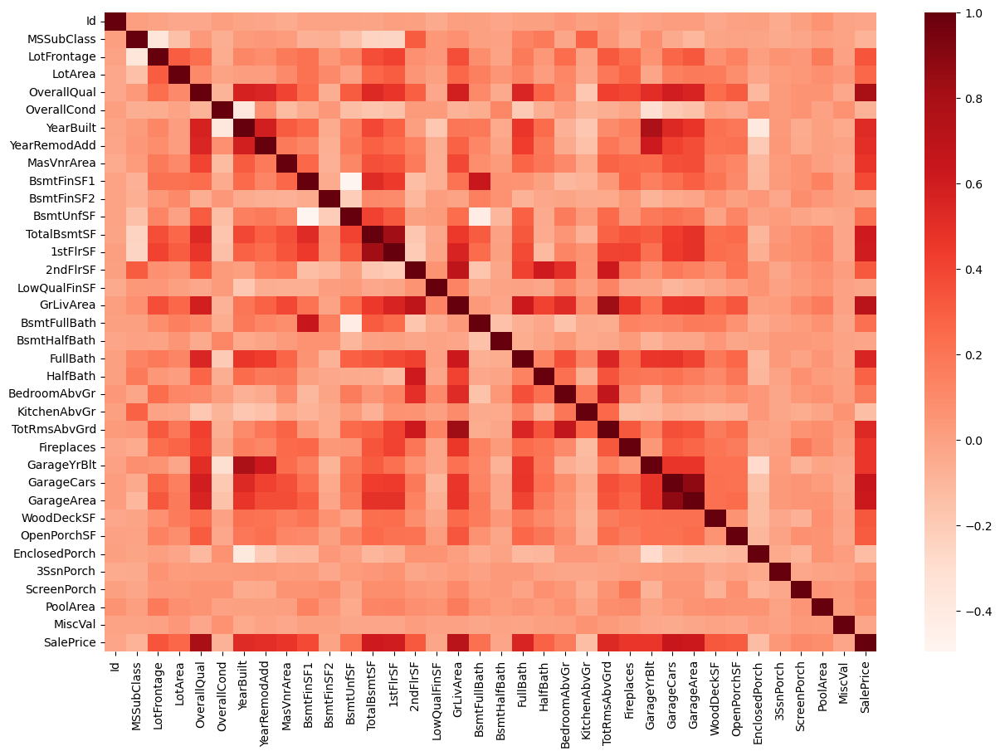

In [42]:
import matplotlib.pyplot as plt
import seaborn as sns

check =pd.concat([num, y_train], axis=1)

plt.figure(figsize=(15, 10))
sns.heatmap(check.corr(),cmap="Reds", annot=False)

In [43]:
# np.abs(-4)

a = check.corr()

a.iloc[1, 2]

-0.35671753042868914

To refine the feature selection, I adapt code from a Stack Overflow [discussion](https://stackoverflow.com/questions/29294983/how-to-calculate-correlation-between-all-columns-and-remove-highly-correlated-on/52509954#52509954) to eliminate features that exhibit strong correlations with others:

I remove features that have a correlation higher than 0.5 with any existing feature in the dataset.

In [44]:
def corr_remove(dataset, threshold):
    # column to be deleted
    col_corr = set() 
    corr_matrix = dataset.corr()
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (np.abs(corr_matrix.iloc[i, j]) >= threshold) and (corr_matrix.columns[j] not in col_corr):
                colname = corr_matrix.columns[i] 
                col_corr.add(colname)
                if colname in dataset.columns:
                    del dataset[colname] 

In [45]:
num_transformed.shape

(1460, 35)

In [46]:
corr_remove(num_transformed, 0.5)

Note that among all 35 numeric features, 15 features are removed because they are highly correlated with at least one features from other 23 remainiang features. 

In [47]:
num_transformed.shape

(1460, 23)

In [48]:
train.select_dtypes(include=np.number).columns.difference(num_transformed.columns) 

Index(['BedroomAbvGr', 'BsmtFullBath', 'FullBath', 'GarageArea', 'GarageCars',
       'GarageYrBlt', 'GrLivArea', 'HalfBath', 'MoSold', 'SalePrice',
       'TotRmsAbvGrd', 'TotalBsmtSF', 'YearBuilt', 'YearRemodAdd', 'YrSold'],
      dtype='object')

Finally, I pare down the list by retaining only those numeric features that show a strong correlation with the house price:

I maintain only those features where the correlation with the target is greater than 0.4. This step ensures that my model considers the most impactful variables.

In [49]:
check =pd.concat([num_transformed, y_train], axis=1)

In [50]:
check.corr()['SalePrice'][:]

Id              -0.021917
MSSubClass      -0.084284
LotFrontage      0.334771
LotArea          0.263843
OverallQual      0.790982
OverallCond     -0.077856
MasVnrArea       0.472614
BsmtFinSF1       0.386420
BsmtFinSF2      -0.011378
BsmtUnfSF        0.214479
1stFlrSF         0.605852
2ndFlrSF         0.319334
LowQualFinSF    -0.025606
BsmtHalfBath    -0.016844
KitchenAbvGr    -0.135907
Fireplaces       0.466929
WoodDeckSF       0.324413
OpenPorchSF      0.315856
EnclosedPorch   -0.128578
3SsnPorch        0.044584
ScreenPorch      0.111447
PoolArea         0.092404
MiscVal         -0.021190
SalePrice        1.000000
Name: SalePrice, dtype: float64

In [51]:
len(check.corr()['SalePrice'][:])

24

In [52]:
check.corr()['SalePrice'].index[1]

'MSSubClass'

In [53]:
check.corr()['SalePrice'][1]

-0.08428413512659508

In [54]:
def corr_keep(dataset, threshold, target):
    # column to be deleted
    keep = []
    corr_matrix = check.corr()
    for i in range(len(corr_matrix[target][:])):
        if np.abs(corr_matrix[target][i]>0.4) and (corr_matrix[target].index[i]!= target):
            keep.append(corr_matrix[target].index[i])
    return dataset[keep]

In [55]:
num_keep = corr_keep(num_transformed, 0.4, 'SalePrice')

Note that only 4 numeric features are highly correlated with the house price. Therefore, out of 23 features, I retain only those 4 that exhibit a correlation greater than 0.4 with the target.

In [56]:
num_keep.shape

(1460, 4)

In [57]:
num_keep.head()

,OverallQual,MasVnrArea,1stFlrSF,Fireplaces
0,0.651479,0.514104,-0.793434,-0.951226
1,-0.071836,-0.570750,0.257140,0.600495
2,0.651479,0.325915,-0.627826,0.600495
3,0.651479,-0.570750,-0.521734,0.600495
4,1.374795,1.366489,-0.045611,0.600495


#### 2.2.2 Select Categorical Features

I aim to select categorical features that:

1. Are not redundant and cannot be represented by other features.
2. Contribute significantly to predicting the targe

Since the Pearson correlation coefficient assumes a linear relationship between features and the target—which is not suitable for the relationship between categorical features and a continuous target—I utilize the **Point-biserial correlation**. This method focuses on differences in means rather than covariance.

Initially, I remove categorical features that show a high Point-biserial correlation with at least one other feature, to reduce redundancy.

In [58]:
from scipy.stats import pointbiserialr

def corr_remove2(dataset, threshold):
    # column to be deleted
    col_corr = set() 
    
    # initialize an empty DataFrame for the correlation matrix
    corr_matrix = pd.DataFrame(index=dataset.columns, columns=dataset.columns)
    
    for col in dataset.columns:
        for j in dataset.columns:
            if col != j:
            # Compute Point-Biserial Correlation
                corr, _ = pointbiserialr(dataset[col], dataset[j])
                corr_matrix.at[col, j] = corr
                corr_matrix.at[j, col] = corr
            
    for i in range(len(corr_matrix.columns)):
        for j in range(i):
            if (np.abs(corr_matrix.iloc[i, j]) >= threshold) and (corr_matrix.columns[j] not in col_corr):
                colname = corr_matrix.columns[i] 
                col_corr.add(colname)
                if colname in dataset.columns:
                    del dataset[colname] 

In [59]:
cat_transformed.shape

(1460, 193)

In [60]:
cat_transformed.head(1)

,MSZoning_FV,MSZoning_RH,MSZoning_RL,MSZoning_RM,Street_Pave,LotShape_IR2,LotShape_IR3,LotShape_Reg,LandContour_HLS,LandContour_Low,LandContour_Lvl,Utilities_NoSeWa,LotConfig_CulDSac,LotConfig_FR2,LotConfig_FR3,LotConfig_Inside,LandSlope_Mod,LandSlope_Sev,Neighborhood_Blueste,Neighborhood_BrDale,Neighborhood_BrkSide,Neighborhood_ClearCr,Neighborhood_CollgCr,Neighborhood_Crawfor,Neighborhood_Edwards,Neighborhood_Gilbert,Neighborhood_IDOTRR,Neighborhood_MeadowV,Neighborhood_Mitchel,Neighborhood_NAmes,Neighborhood_NPkVill,Neighborhood_NWAmes,Neighborhood_NoRidge,Neighborhood_NridgHt,Neighborhood_OldTown,Neighborhood_SWISU,Neighborhood_Sawyer,Neighborhood_SawyerW,Neighborhood_Somerst,Neighborhood_StoneBr,Neighborhood_Timber,Neighborhood_Veenker,Condition1_Feedr,Condition1_Norm,Condition1_PosA,Condition1_PosN,Condition1_RRAe,Condition1_RRAn,Condition1_RRNe,Condition1_RRNn,Condition2_Feedr,Condition2_Norm,Condition2_PosA,Condition2_PosN,Condition2_RRAe,Condition2_RRAn,Condition2_RRNn,BldgType_2fmCon,BldgType_Duplex,BldgType_Twnhs,BldgType_TwnhsE,HouseStyle_1.5Unf,HouseStyle_1Story,HouseStyle_2.5Fin,HouseStyle_2.5Unf,HouseStyle_2Story,HouseStyle_SFoyer,HouseStyle_SLvl,RoofStyle_Gable,RoofStyle_Gambrel,RoofStyle_Hip,RoofStyle_Mansard,RoofStyle_Shed,RoofMatl_CompShg,RoofMatl_Membran,RoofMatl_Metal,RoofMatl_Roll,RoofMatl_Tar&Grv,RoofMatl_WdShake,RoofMatl_WdShngl,Exterior1st_AsphShn,Exterior1st_BrkComm,Exterior1st_BrkFace,Exterior1st_CBlock,Exterior1st_CemntBd,Exterior1st_HdBoard,Exterior1st_ImStucc,Exterior1st_MetalSd,Exterior1st_Plywood,Exterior1st_Stone,Exterior1st_Stucco,Exterior1st_VinylSd,Exterior1st_Wd Sdng,Exterior1st_WdShing,Exterior2nd_AsphShn,Exterior2nd_Brk Cmn,Exterior2nd_BrkFace,Exterior2nd_CBlock,Exterior2nd_CmentBd,Exterior2nd_HdBoard,Exterior2nd_ImStucc,Exterior2nd_MetalSd,Exterior2nd_Other,Exterior2nd_Plywood,Exterior2nd_Stone,Exterior2nd_Stucco,Exterior2nd_VinylSd,Exterior2nd_Wd Sdng,Exterior2nd_Wd Shng,ExterQual_Fa,ExterQual_Gd,ExterQual_TA,ExterCond_Fa,ExterCond_Gd,ExterCond_Po,ExterCond_TA,Foundation_CBlock,Foundation_PConc,Foundation_Slab,Foundation_Stone,Foundation_Wood,BsmtQual_Fa,BsmtQual_Gd,BsmtQual_TA,BsmtCond_Gd,BsmtCond_Po,BsmtCond_TA,BsmtExposure_Gd,BsmtExposure_Mn,BsmtExposure_No,BsmtFinType1_BLQ,BsmtFinType1_GLQ,BsmtFinType1_LwQ,BsmtFinType1_Rec,BsmtFinType1_Unf,BsmtFinType2_BLQ,BsmtFinType2_GLQ,BsmtFinType2_LwQ,BsmtFinType2_Rec,BsmtFinType2_Unf,Heating_GasA,Heating_GasW,Heating_Grav,Heating_OthW,Heating_Wall,HeatingQC_Fa,HeatingQC_Gd,HeatingQC_Po,HeatingQC_TA,CentralAir_Y,Electrical_FuseF,Electrical_FuseP,Electrical_Mix,Electrical_SBrkr,KitchenQual_Fa,KitchenQual_Gd,KitchenQual_TA,Functional_Maj2,Functional_Min1,Functional_Min2,Functional_Mod,Functional_Sev,Functional_Typ,GarageType_Attchd,GarageType_Basment,GarageType_BuiltIn,GarageType_CarPort,GarageType_Detchd,GarageFinish_RFn,GarageFinish_Unf,GarageQual_Fa,GarageQual_Gd,GarageQual_Po,GarageQual_TA,GarageCond_Fa,GarageCond_Gd,GarageCond_Po,GarageCond_TA,PavedDrive_P,PavedDrive_Y,SaleType_CWD,SaleType_Con,SaleType_ConLD,SaleType_ConLI,SaleType_ConLw,SaleType_New,SaleType_Oth,SaleType_WD,SaleCondition_AdjLand,SaleCondition_Alloca,SaleCondition_Family,SaleCondition_Normal,SaleCondition_Partial
0,0,0,1,0,1,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,0,1,0,1,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,1,1,0,0,0,0,1,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0


In [61]:
corr_remove2(cat_transformed, 0.5)

Note that among all 193 categorical features, 42 features are removed because they show high correlation with at least one of the remaining 151 features.

In [62]:
cat_transformed.shape

(1460, 151)

Finally, I further refine the selection of categorical features by keeping only those that are highly correlated with the house price.Specifically, I retain only those features whose correlation with the target exceeds 0.4. This ensures that the selected features have a substantial impact on the model’s predictive capability.

In [63]:
def corr_keep(dataset, threshold, target):
    # column to be deleted
    keep = []
    check =pd.concat([dataset, y_train], axis=1)
    corr_matrix = pd.DataFrame(index=check.columns, columns=check.columns)
    for col in check.columns:
        for j in check.columns:
            # Compute Point-Biserial Correlation
            corr, _ = pointbiserialr(check[col], check[j])
            corr_matrix.at[col, j] = corr
            corr_matrix.at[j, col] = corr
    for i in range(len(corr_matrix[target][:])):
        if np.abs(corr_matrix[target][i]>0.4) and (corr_matrix[target].index[i]!= target):
            keep.append(corr_matrix[target].index[i])
    return dataset[keep], corr_matrix

In [64]:
cat_keep,pb_corr = corr_keep(cat_transformed, 0.4, 'SalePrice')

Note that only 3 categorical features are highly correlated with the house price. Therefore, out of 151 features, I keep only those 3 that exhibit a correlation greater than 0.4 with the target.

In [65]:
cat_keep.head()

,Neighborhood_NridgHt,ExterQual_Gd,BsmtFinType1_GLQ
0,0,1,1
1,0,0,0
2,0,1,1
3,0,0,0
4,0,1,1


In [66]:
cat_keep.shape

(1460, 3)

#### 2.2.3 Jointly Select Numerical and Categorical Features

In this section, I enhance the feature set using **mutual_info_regression**, a measure from information theory that quantifies the mutual information between two variables. This metric helps determine how much knowing one variable reduces uncertainty about the other. The higher the mutual information (I(X;Y)), the greater the shared information between feature X and target Y.

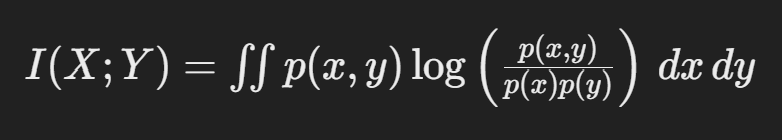

In [67]:
features = pd.concat([num_transformed, cat_transformed], axis=1)
features.shape

(1460, 174)

In [68]:
from sklearn.feature_selection import mutual_info_regression
mutual_info = mutual_info_regression(features, y_train)

In [69]:
mutual_info = pd.DataFrame(mutual_info, index=features.columns, columns=['Mutual Information'])
mutual_info = mutual_info.sort_values(['Mutual Information'],  ascending=False)
mutual_info

,Mutual Information
OverallQual,0.561304
1stFlrSF,0.309024
MSSubClass,0.274180
LotFrontage,0.224372
ExterQual_Gd,0.218148
...,...
Exterior2nd_ImStucc,0.000000
ExterCond_Po,0.000000
BsmtCond_Gd,0.000000
BsmtFinType2_LwQ,0.000000


Text(0.5, 1.0, 'Mutual Information Scores')

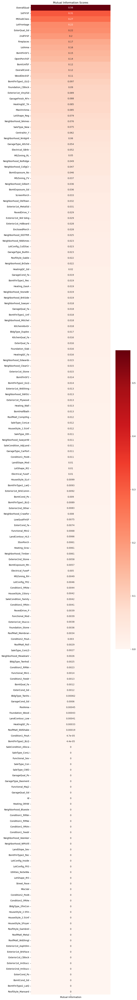

In [70]:
plt.figure(figsize=(8, 80))
sns.heatmap(data=mutual_info, annot=True, cmap="Reds" )
plt.title('Mutual Information Scores')

The results align well with those from linear correlation analyses:

1. The top three numeric features identified through Pearson correlation—OverallQual, MasVnrArea, and 1stFlrSF—are also highlighted by mutual information, underscoring their importance.
2. Similarly, ExterQual_Gd and BsmtFinType1_GLQ, which are among the top three categorical features identified through Point-biserial correlation, also exhibit high mutual information scores.
3. Additionally, new features that demonstrate significant shared information with the target variable have emerged. I will consider including those features with a mutual information score greater than 0.2.

In [71]:
add = mutual_info[mutual_info['Mutual Information'] > 0.2]  

In [72]:
# add.columns - num_keep.columns-cat_keep.columns

new_columns = set(add.index)
old_keep = set(num_keep + cat_keep)
new_keep = new_columns - old_keep
new_keep

{'LotFrontage', 'MSSubClass'}

In [73]:
list(new_keep)

['MSSubClass', 'LotFrontage']

In [74]:
train_keep = pd.concat([num_keep, cat_keep, features[list(new_keep)], year_month[['is_crisis', 'seasonal']]], axis=1)

In [75]:
train_keep.shape

(1460, 11)

In [76]:
train_keep.head()

,OverallQual,MasVnrArea,1stFlrSF,Fireplaces,Neighborhood_NridgHt,ExterQual_Gd,BsmtFinType1_GLQ,MSSubClass,LotFrontage,is_crisis,seasonal
0,0.651479,0.514104,-0.793434,-0.951226,0,1,1,0.073375,-0.220875,1,0.975592
1,-0.071836,-0.570750,0.257140,0.600495,0,0,0,-0.872563,0.460320,0,0.930405
2,0.651479,0.325915,-0.627826,0.600495,0,1,1,0.073375,-0.084636,1,1.101929
3,0.651479,-0.570750,-0.521734,0.600495,0,0,0,0.309859,-0.447940,0,0.975592
4,1.374795,1.366489,-0.045611,0.600495,0,1,1,0.073375,0.641972,1,1.112861


## 3. Model Selection

In this section, I will use a **Stacking Model**, which combines multiple base models using a meta-model to improve predictive performance. The code is adapted from [here](https://machinelearningmastery.com/stacking-ensemble-machine-learning-with-python/).


- Multiple base models: These models are fit on the training data and make predictions. For this study, I consider a decision tree regressor, random forest regressor, K-nearest neighbor Regressor, and Support Vector Regression.
- Meta-model: This is a simpler model that learns how to best combine the predictions from base models. For regression tasks, this is often a linear regression model, and for classification tasks, a logistic regression.

In [77]:
from sklearn.neighbors import KNeighborsRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.svm import SVR
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import StackingRegressor

# get a stacking ensemble of models
    #  add random_state if you want a fixed result
def get_stacking():
 # base models
    level0 = list()
    level0.append(('dt', DecisionTreeRegressor()))
    level0.append(('rf', RandomForestRegressor()))
    level0.append(('knn', KNeighborsRegressor()))
    level0.append(('svr', SVR()))
 # meta model
    level1 = LinearRegression()
 # stacking ensemble
    model = StackingRegressor(estimators=level0, final_estimator=level1, cv=5)
    return model

Let's compare the performace (RMSE)  of each base model and stacking model:

In [78]:
def get_models():
    models = dict()
    models['dt'] = DecisionTreeRegressor()
    models['rf'] = RandomForestRegressor()
    models['knn'] = KNeighborsRegressor()
    models['svr'] = SVR()
    models['stacking'] = get_stacking()

    return models

In [79]:
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import RepeatedKFold

# evaluate root mean squared error a given model using cross-validation
    # returns a list of scores from three repeats of 5-fold cross-validation
def evaluate_model(model, X, y):
    cv = RepeatedKFold(n_splits=5, n_repeats=3, random_state=123)
    scores = cross_val_score(model, X, y, scoring='neg_mean_squared_error', cv=cv, n_jobs=-1, error_score='raise')
    scores = np.sqrt(np.abs(scores))
    return scores

In [80]:
# get the models to evaluate
models = get_models()

print(models)

{'dt': DecisionTreeRegressor(), 'rf': RandomForestRegressor(), 'knn': KNeighborsRegressor(), 'svr': SVR(), 'stacking': StackingRegressor(cv=5,
                  estimators=[('dt', DecisionTreeRegressor()),
                              ('rf', RandomForestRegressor()),
                              ('knn', KNeighborsRegressor()), ('svr', SVR())],
                  final_estimator=LinearRegression())}


In [81]:
# compare ensemble to each standalone models for regression
from numpy import mean
from numpy import std

# evaluate rmse of the models
results, names = list(), list()
for name, model in models.items():
    scores = evaluate_model(model, train_keep, y_train)
    results.append(scores)
    names.append(name)
    print('>%s %.3f (%.3f)' % (name, mean(scores), std(scores)))

>dt 49695.847 (3939.682)
>rf 37464.854 (3302.064)
>knn 40492.017 (3474.521)
>svr 81324.289 (3600.750)
>stacking 37036.028 (3599.440)


In [82]:
results

[array([45902.04150125, 48112.2464384 , 46580.59169623, 49047.72734119,
        52615.87382404, 51572.09687983, 52821.0644933 , 53714.32516982,
        44074.5700244 , 46607.96667075, 45652.55968776, 50334.27586125,
        58041.57942387, 54642.36142452, 45718.41828542]),
 array([33895.01130785, 37975.60013574, 41053.15300247, 34402.61318949,
        41811.99872437, 36980.45171841, 42077.93198262, 37894.28596604,
        36181.2529947 , 32732.47297597, 30423.0494922 , 37981.9640195 ,
        40193.44415021, 39654.00375807, 38715.5742157 ]),
 array([37114.34002845, 41804.03583357, 40542.59947904, 38524.83215098,
        40207.3460472 , 39795.9342905 , 49568.89470576, 40088.77468317,
        39090.99333013, 37042.49034335, 34500.51056049, 39192.83470864,
        42846.92587046, 45190.17600558, 41869.56641162]),
 array([80989.11603531, 82329.09012469, 81430.20832479, 80680.41971538,
        81434.99953215, 86576.23433056, 86604.24078266, 72839.74927246,
        80933.68219265, 79664.3787

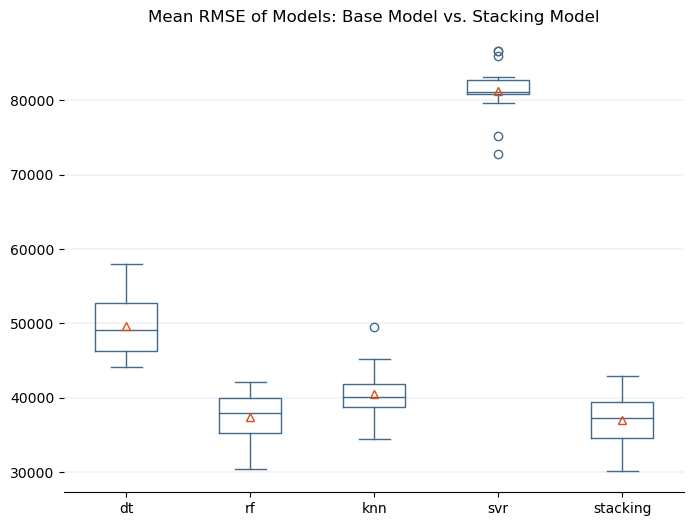

In [83]:
from matplotlib import pyplot

box_color = '#426A8C'

fig, ax = plt.subplots(figsize=(8, 6))
# Remove top, right, left border
ax.spines['top'].set_visible(False)
ax.spines['right'].set_visible(False)
ax.spines['left'].set_visible(False)

# Set plot title
ax.set_title('Mean RMSE of Models: Base Model vs. Stacking Model')

# Add major gridlines in the y-axis
ax.grid(color='grey', axis='y', linestyle='-', linewidth=0.25, alpha=0.5)


meanprops = dict(marker='^', markerfacecolor='none', markeredgecolor='#D94D1A')

# plot model performance for comparison
pyplot.boxplot(results, labels=names, showmeans=True, 
                 meanprops=meanprops,
                 boxprops=dict(color=box_color),
                 capprops=dict(color=box_color),
                 whiskerprops=dict(color=box_color),
                 flierprops=dict(markeredgecolor=box_color),
                 medianprops=dict(color=box_color))


pyplot.show()

The comparison focuses on the root mean squared error (RMSE) where a lower RMSE indicates better model performance. The findings are:

1. The Stacking Model exhibits the best performance among all evaluated models.
2. The Random Forest, another ensemble model based on bagging, performs similarly to the stacking model.
3. Both the stacking model and random forest significantly outperform K-nearest neighbors, decision tree, and SVM in terms of lower median error and a smaller interquartile range (IQR).

Further comparison between the Random Forest and Stacking Model could be conducted if test features and targets are available. Unfortunately, the open dataset does not provide the target for the test set.

Lastly, the trained stacking model is saved for later use.

## 4. Model Prediction


### 4.1 Prediction within Same Session

In [84]:
# test = pd.read_csv('../Kaggle/house-prices-advanced-regression-techniques/test.csv')

test = test.apply(lambda col: col.fillna(col.median()) if col.dtype != 'object' else col.fillna(col.mode().iloc[0]))

test_num= test.select_dtypes(include=np.number)
test_cat= test.select_dtypes(include="object") 

# y_test = test_num['SalePrice'] # No target in the testset
year_month2 = test_num[['MoSold','YrSold']]


test['YearMonthSold'] = pd.to_datetime(test['YrSold'].astype(str) + '-' + test['MoSold'].astype(str))
year_month2['YearMonthSold'] = pd.to_datetime(year_month2['YrSold'].astype(str) + '-' + year_month2['MoSold'].astype(str))

test_num = pd.DataFrame(scaler.fit_transform(test_num), columns=test_num.columns)
test_cat = pd.get_dummies(test_cat)

year_month2 = year_month2.merge(temp[['YearMonthSold', 'is_crisis', 'seasonal']], on='YearMonthSold', how='left')

C:\Users\zihan\AppData\Local\Temp\ipykernel_16752\2540218913.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  year_month2['YearMonthSold'] = pd.to_datetime(year_month2['YrSold'].astype(str) + '-' + year_month2['MoSold'].astype(str))


In [85]:
test.shape

(1459, 81)

In [86]:
test_all = pd.concat([test_num, test_cat, year_month2], axis=1)

In [87]:
test.head(1)

,Id,MSSubClass,MSZoning,LotFrontage,LotArea,Street,Alley,LotShape,LandContour,Utilities,LotConfig,LandSlope,Neighborhood,Condition1,Condition2,BldgType,HouseStyle,OverallQual,OverallCond,YearBuilt,YearRemodAdd,RoofStyle,RoofMatl,Exterior1st,Exterior2nd,MasVnrType,MasVnrArea,ExterQual,ExterCond,Foundation,BsmtQual,BsmtCond,BsmtExposure,BsmtFinType1,BsmtFinSF1,BsmtFinType2,BsmtFinSF2,BsmtUnfSF,TotalBsmtSF,Heating,HeatingQC,CentralAir,Electrical,1stFlrSF,2ndFlrSF,LowQualFinSF,GrLivArea,BsmtFullBath,BsmtHalfBath,FullBath,HalfBath,BedroomAbvGr,KitchenAbvGr,KitchenQual,TotRmsAbvGrd,Functional,Fireplaces,FireplaceQu,GarageType,GarageYrBlt,GarageFinish,GarageCars,GarageArea,GarageQual,GarageCond,PavedDrive,WoodDeckSF,OpenPorchSF,EnclosedPorch,3SsnPorch,ScreenPorch,PoolArea,PoolQC,Fence,MiscFeature,MiscVal,MoSold,YrSold,SaleType,SaleCondition,YearMonthSold
0,1461,20,RH,80.0,11622,Pave,Grvl,Reg,Lvl,AllPub,Inside,Gtl,NAmes,Feedr,Norm,1Fam,1Story,5,6,1961,1961,Gable,CompShg,VinylSd,VinylSd,None,0.0,TA,TA,CBlock,TA,TA,No,Rec,468.0,LwQ,144.0,270.0,882.0,GasA,TA,Y,SBrkr,896,0,0,896,0.0,0.0,1,0,2,1,TA,5,Typ,0,Gd,Attchd,1961.0,Unf,1.0,730.0,TA,TA,Y,140,0,0,0,120,0,Ex,MnPrv,Shed,0,6,2010,WD,Normal,2010-06-01


In [88]:
test_keep = test_all[train_keep.columns.to_list()]
test_keep.head()

,OverallQual,MasVnrArea,1stFlrSF,Fireplaces,Neighborhood_NridgHt,ExterQual_Gd,BsmtFinType1_GLQ,MSSubClass,LotFrontage,is_crisis,seasonal
0,-0.751101,-0.563316,-0.654561,-0.898055,0,0,0,-0.874711,0.567330,1,1.023042
1,-0.054877,0.047057,0.433298,-0.898055,0,0,0,-0.874711,0.615963,1,1.023042
2,-0.751101,-0.563316,-0.574165,0.647066,0,0,1,0.061351,0.275532,1,0.980789
3,-0.054877,-0.450284,-0.579190,0.647066,0,0,1,0.061351,0.470064,1,1.023042
4,1.337571,-0.563316,0.310192,-0.898055,0,1,0,1.465443,-1.232092,1,0.878202


In [89]:
m_s = get_stacking()

In [90]:
m_s.fit(train_keep, y_train)

StackingRegressor(cv=5,
                  estimators=[('dt', DecisionTreeRegressor()),
                              ('rf', RandomForestRegressor()),
                              ('knn', KNeighborsRegressor()), ('svr', SVR())],
                  final_estimator=LinearRegression())

In [91]:
preds = m_s.predict(test_keep)

In [92]:
preds

array([133484.37606411, 153636.64498574, 148104.78455953, ...,
       199884.07766595, 145929.58486157, 195074.51648278])

In [93]:
preds_series = pd.Series(preds, name='SalePrice')
preds

array([133484.37606411, 153636.64498574, 148104.78455953, ...,
       199884.07766595, 145929.58486157, 195074.51648278])

In [94]:
output =  pd.concat([test['Id'], preds_series], axis=1)

In [95]:
output.head()

,Id,SalePrice
0,1461,133484.376064
1,1462,153636.644986
2,1463,148104.784560
3,1464,194916.569619
4,1465,200046.419651


In [96]:
# sample = pd.read_csv('../Kaggle/house-prices-advanced-regression-techniques/sample_submission.csv')
# sample.head()

In [97]:
output.to_csv('housing_submission_02.csv', index=False)

Kaggle provided the score as 0.18558/0.18753, which seems to be a decent RMSE score. 

In [98]:
# check = m_s.predict(train_keep)

# import math
# MSE = np.square(np.subtract(y_train,check)).mean()   
# math.sqrt(MSE)  

15523.712845470101

### 4.2 Prediction after Saving and Reloading

In [98]:
import joblib

# Save the stacking model
joblib.dump(m_s, 'stacking_model.pkl')

['stacking_model.pkl']

In [99]:
import pickle

model_config = models['stacking'].get_params()

# Assuming `model_config` is your configuration dictionary
    # and it may contain complex objects like sklearn estimators

def save_config(model_config, file_name):
    with open(file_name, 'wb') as f:
        pickle.dump(model_config, f)

# Example usage:
save_config(model_config, 'stacking_model_config.pkl')

**Method 1: loading model and make prediction**

In [100]:
from joblib import load

# Method1: Load the model
stacking_model_loaded = load('stacking_model.pkl')

# Now you can use `stacking_model_loaded` to make predictions
predictions = stacking_model_loaded.predict(test_keep)
predictions

array([133484.37606411, 153636.64498574, 148104.78455953, ...,
       199884.07766595, 145929.58486157, 195074.51648278])

**Method2: loading config and make prediction**

In [101]:
def load_config(file_name):
    with open(file_name, 'rb') as f:
        return pickle.load(f)

loaded_model_config = load_config('stacking_model_config.pkl')

In [102]:
loaded_model_config

{'cv': 5,
 'estimators': [('dt', DecisionTreeRegressor()),
  ('rf', RandomForestRegressor()),
  ('knn', KNeighborsRegressor()),
  ('svr', SVR())],
 'final_estimator__copy_X': True,
 'final_estimator__fit_intercept': True,
 'final_estimator__n_jobs': None,
 'final_estimator__positive': False,
 'final_estimator': LinearRegression(),
 'n_jobs': None,
 'passthrough': False,
 'verbose': 0,
 'dt': DecisionTreeRegressor(),
 'rf': RandomForestRegressor(),
 'knn': KNeighborsRegressor(),
 'svr': SVR(),
 'dt__ccp_alpha': 0.0,
 'dt__criterion': 'squared_error',
 'dt__max_depth': None,
 'dt__max_features': None,
 'dt__max_leaf_nodes': None,
 'dt__min_impurity_decrease': 0.0,
 'dt__min_samples_leaf': 1,
 'dt__min_samples_split': 2,
 'dt__min_weight_fraction_leaf': 0.0,
 'dt__random_state': None,
 'dt__splitter': 'best',
 'rf__bootstrap': True,
 'rf__ccp_alpha': 0.0,
 'rf__criterion': 'squared_error',
 'rf__max_depth': None,
 'rf__max_features': 1.0,
 'rf__max_leaf_nodes': None,
 'rf__max_samples': N

In [103]:
def get_stacking2(config=None):
    
    # Base models configuration
    model_classes = {
        'dt': DecisionTreeRegressor,
        'rf': RandomForestRegressor,
        'knn': KNeighborsRegressor,
        'svr': SVR
    }

    # Prepare the base models with parameters from the config
    level0 = []
    for model_key, model_class in model_classes.items():
        model_params = {k[len(model_key)+2:]: v for k, v in config.items() if k.startswith(model_key + '__')}
        model_instance = model_class(**model_params)
        level0.append((model_key, model_instance))
    
    # Meta model configuration
    final_estimator = LinearRegression(
        copy_X=config.get('final_estimator__copy_X', True),
        fit_intercept=config.get('final_estimator__fit_intercept', True),
        n_jobs=config.get('final_estimator__n_jobs', None),
        positive=config.get('final_estimator__positive', False)
    )
    
    # Stacking ensemble with meta model
    model = StackingRegressor(
        estimators=level0,
        final_estimator=final_estimator,
        cv=config.get('cv', 5),
        n_jobs=config.get('n_jobs', None),
        passthrough=config.get('passthrough', False),
        verbose=config.get('verbose', 0)
    )
    
    return model
    # Stacking ensemble
    model = StackingRegressor(estimators=level0, final_estimator=level1, cv=5)
    return model

In [104]:
model_withconfig = get_stacking2(loaded_model_config)

In [105]:
model_withconfig.fit(train_keep, y_train)

StackingRegressor(cv=5,
                  estimators=[('dt', DecisionTreeRegressor()),
                              ('rf', RandomForestRegressor()),
                              ('knn', KNeighborsRegressor()), ('svr', SVR())],
                  final_estimator=LinearRegression())

In [106]:
model_withconfig.predict(test_keep)

array([128931.78045865, 152448.92542944, 154675.44420629, ...,
       185372.92535432, 146144.54810877, 200581.53545804])

The difference in results could be attributed to the use of different random seeds

## 5. Model Interpretation

In [107]:
# After fitting the stacking model
# Base Model Feature Importances
for name, model in m_s.named_estimators_.items():
    if hasattr(model, 'feature_importances_'):
        print(f"{name} model feature importances:", model.feature_importances_)

# Meta-Model Coefficients
print("Meta-model coefficients:", m_s.final_estimator_.coef_)

dt model feature importances: [0.67442908 0.05128262 0.13228423 0.01627452 0.00138042 0.01277931
 0.00715646 0.02249201 0.05311938 0.00503534 0.02376663]
rf model feature importances: [0.64921759 0.05246368 0.12835881 0.028786   0.0019317  0.0101092
 0.00930657 0.02990381 0.0602986  0.00485764 0.02476641]
Meta-model coefficients: [ 0.2203046   0.51889505  0.27976539 -0.15587399]


We can get the feature importances from stacking model: specifically, from decision tree model and random forest model in the base models. Let's visualize for the feature importance:

In [108]:
# get importance value
feature_importances = {}
for name, model in m_s.named_estimators_.items():
    if hasattr(model, 'feature_importances_'):
        feature_importances[name] = model.feature_importances_

In [109]:
#get and check column name of feature importance 
m_s.named_estimators_['dt'].feature_names_in_

array(['OverallQual', 'MasVnrArea', '1stFlrSF', 'Fireplaces',
       'Neighborhood_NridgHt', 'ExterQual_Gd', 'BsmtFinType1_GLQ',
       'MSSubClass', 'LotFrontage', 'is_crisis', 'seasonal'], dtype=object)

In [110]:
m_s.named_estimators_['rf'].feature_names_in_

array(['OverallQual', 'MasVnrArea', '1stFlrSF', 'Fireplaces',
       'Neighborhood_NridgHt', 'ExterQual_Gd', 'BsmtFinType1_GLQ',
       'MSSubClass', 'LotFrontage', 'is_crisis', 'seasonal'], dtype=object)

In [111]:
train_keep.columns

Index(['OverallQual', 'MasVnrArea', '1stFlrSF', 'Fireplaces',
       'Neighborhood_NridgHt', 'ExterQual_Gd', 'BsmtFinType1_GLQ',
       'MSSubClass', 'LotFrontage', 'is_crisis', 'seasonal'],
      dtype='object')

In [112]:
# dir(m_s.named_estimators_['dt'])

In [113]:
# Create DataFrame for feature importances
features_df = pd.DataFrame(feature_importances, index=train_keep.columns.to_list())
features_df

,dt,rf
OverallQual,0.674429,0.649218
MasVnrArea,0.051283,0.052464
1stFlrSF,0.132284,0.128359
Fireplaces,0.016275,0.028786
Neighborhood_NridgHt,0.001380,0.001932
ExterQual_Gd,0.012779,0.010109
BsmtFinType1_GLQ,0.007156,0.009307
MSSubClass,0.022492,0.029904
LotFrontage,0.053119,0.060299
is_crisis,0.005035,0.004858


In [114]:
features_df=features_df.sort_values(by='rf', ascending=False)
features_df

,dt,rf
OverallQual,0.674429,0.649218
1stFlrSF,0.132284,0.128359
LotFrontage,0.053119,0.060299
MasVnrArea,0.051283,0.052464
MSSubClass,0.022492,0.029904
Fireplaces,0.016275,0.028786
seasonal,0.023767,0.024766
ExterQual_Gd,0.012779,0.010109
BsmtFinType1_GLQ,0.007156,0.009307
is_crisis,0.005035,0.004858


We can extract feature importances specifically from the decision tree and random forest models within the base layers of the stacking model. Let's visualize these feature importances:", "The visualization reveals that the feature importances from both the decision tree and random forest models align closely. The 'OverallQual' feature stands out as the most significant predictor of house price, corroborating its highest correlation with house price observed in the data analysis.

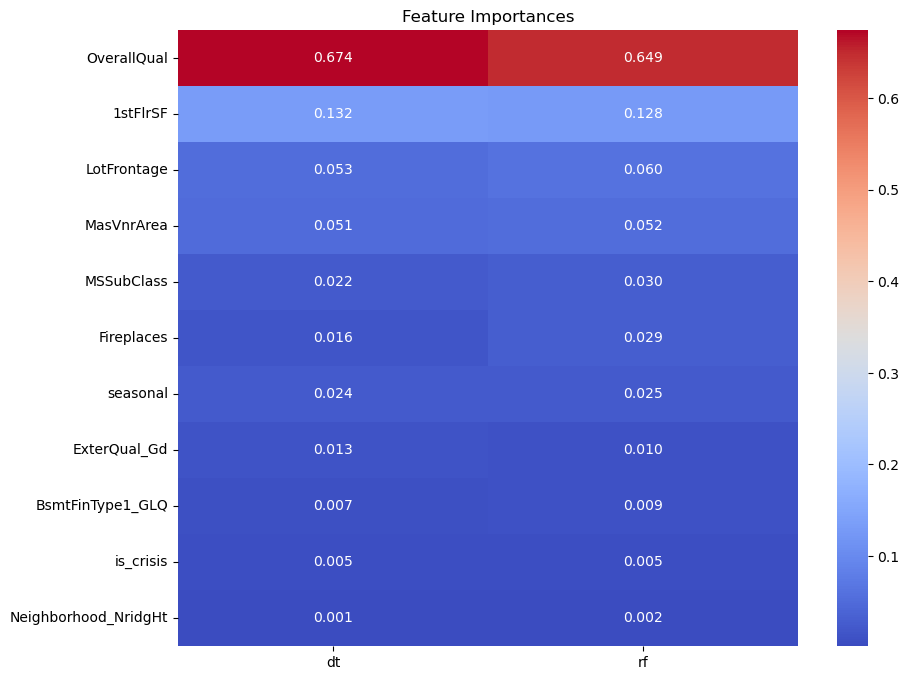

In [115]:
# Plotting feature importances
plt.figure(figsize=(10, 8))
sns.heatmap(features_df, annot=True, cmap='coolwarm', fmt=".3f")
plt.title('Feature Importances')
plt.show()

Additionally, we can evaluate the model importances through the coefficients from the final_estimator_ (meta-model) in the stacking ensemble. The coefficients indicate the relative importance of each base model's predictions. The heatmap and results show that the stacking model's predictions heavily rely on the random forest model.

In [116]:
# Create DataFrame for model importances
model_importances = pd.DataFrame({
    'Importance': m_s.final_estimator_.coef_
}, index=list(m_s.named_estimators_.keys()))

In [117]:
model_importances

,Importance
dt,0.220305
rf,0.518895
knn,0.279765
svr,-0.155874


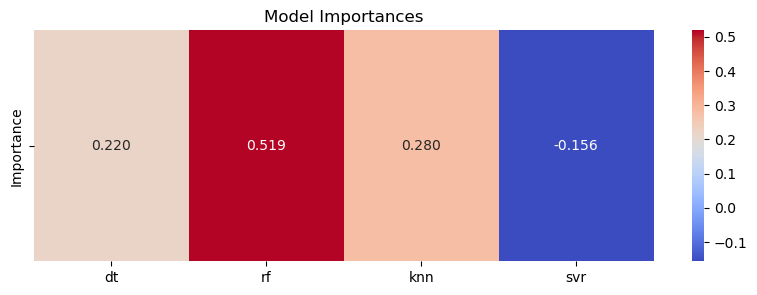

In [118]:
print
# Plotting model importances
plt.figure(figsize=(10, 3))
sns.heatmap(model_importances.T, annot=True, cmap='coolwarm', fmt=".3f")
plt.title('Model Importances')
plt.show()

## 6. Tuning Parameter of Stacking Model

In this section, I fine-tuned the parameters of the base models to enhance the performance of the stacking model using **grid search**.

In [140]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'dt__max_depth': [5, 10, 20, 30],
    'dt__min_samples_split': [2, 10, 20],
    'rf__n_estimators': [50, 100, 200],
    'rf__max_depth': [5, 10, 20,30],
    'knn__n_neighbors': [3, 5, 7],
    'svr__C': [0.1, 1.0, 10.0]
}

In [141]:
stacking_model = get_stacking()

In [142]:
grid = GridSearchCV(estimator=stacking_model, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error', n_jobs=-1)
grid_result = grid.fit(train_keep, y_train)

In [143]:
# best parameters
print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

Best: -1318558866.991471 using {'dt__max_depth': 5, 'dt__min_samples_split': 2, 'knn__n_neighbors': 3, 'rf__max_depth': 10, 'rf__n_estimators': 100, 'svr__C': 1.0}


In [148]:
# Root Mean Squared Error
np.sqrt(-grid.best_score_)

36311.96589268434

In [144]:
best_model = grid_result.best_estimator_

predictions = best_model.predict(test_keep)
predictions

array([128644.84566776, 154055.15031579, 153453.83926548, ...,
       184205.6337156 , 142133.52979281, 204574.14661049])

In [149]:
preds_series = pd.Series(predictions, name='SalePrice')
preds

output =  pd.concat([test['Id'], preds_series], axis=1)

output.to_csv('housing_submission_bestmodel.csv', index=False)

The optimized model achieved a public score of 0.18481, marking a 0.4% improvement over the initial stacking model configuration

In [145]:
# save the best model
joblib.dump(best_model, 'best_stacking_model.pkl')

['best_stacking_model.pkl']

# References
1. https://www.analyticsvidhya.com/blog/2023/02/various-techniques-to-detect-and-isolate-time-series-components-using-python/
2. https://www.geeksforgeeks.org/time-series-decomposition-techniques/
3. https://www.kaggle.com/code/guoyiyang92/simple-feature-selection-categorical-continuous
4. https://datascience.stackexchange.com/questions/47715/whats-the-difference-between-feature-importance-from-random-forest-and-pearson
5. https://stats.stackexchange.com/questions/102778/correlations-between-continuous-and-categorical-nominal-variables
6. https://www.statology.org/pearson-correlation-assumptions/
7. https://medium.com/@ktoprakucar/how-to-calculate-the-correlation-between-categorical-and-continuous-values-dcb7abf79406
8. https://stackoverflow.com/questions/66221834/how-to-create-a-custom-python-class-to-be-used-in-pipeline-for-dropping-highly-c
9. https://stats.stackexchange.com/questions/557974/whats-the-correct-approach-to-measure-correlation-in-binary-problems
10. https://towardsdatascience.com/ensemble-model-selection-evaluation-in-machine-learning-by-optimalflow-9e5126308f12
11. https://machinelearningmastery.com/stacking-ensemble-machine-learning-with-python/
12. https://datascience.stackexchange.com/questions/93531/neg-mean-squared-error-in-cross-val-score
13. https://towardsdatascience.com/data-science-with-python-intro-to-data-visualization-and-matplotlib-5f799b7c6d82
14. https://towardsdatascience.com/create-and-customize-boxplots-with-pythons-matplotlib-to-get-lots-of-insights-from-your-data-d561c9883643
15. https://www.kaggle.com/code/theforcecoder/eda-hyperparameter-tuning-stacking
16. https://www.kaggle.com/code/gusthema/house-prices-prediction-using-tfdf

In [ ]:
check 